In [1]:
import cv2
import json
import keras
from keras.applications.imagenet_utils import preprocess_input
from keras.backend.tensorflow_backend import set_session
from keras.models import Model
from keras.preprocessing import image
import matplotlib.pyplot as plt
import numpy as np
import os
import pickle
from random import shuffle
from scipy.misc import imread
from scipy.misc import imresize
import sklearn
import tensorflow as tf

from ssd import SSD300
from ssd_training import MultiboxLoss
from ssd_utils import BBoxUtility

%matplotlib inline
plt.rcParams['figure.figsize'] = (8, 8)
plt.rcParams['image.interpolation'] = 'nearest'

np.set_printoptions(suppress=True)

# config = tf.ConfigProto()
# config.gpu_options.per_process_gpu_memory_fraction = 0.9
# set_session(tf.Session(config=config))

np.random.seed(1)

Using TensorFlow backend.


In [2]:
# some constants and paths

# 7 fish plus background class
NUM_CLASSES = 8
input_shape = (300, 300, 3)

# path of the training images WITHOUT the category folders
path_prefix = '/home/mzhao/Desktop/kaggle/ncfm/train_all_together/'

# annotations I made, pushed in the src folder
# gt_path = '/home/mzhao/Desktop/kaggle/ncfm/src/SSD/annotations.pkl'
bbox_path = '/home/mzhao/Desktop/kaggle/ncfm/bbox_annotations'

# files that come in the ssd_keras repo
ssd300_weights = 'weights_SSD300.hdf5'
prior_boxes = 'prior_boxes_ssd300.pkl'

In [3]:
annotation_files = ['alb_labels.json',
                    'bet_labels.json',
                    'dol_labels.json',
                    'lag_labels.json',
                    'other_labels.json',
                    'shark_labels.json',
                    'yft_labels.json']
bbox = {}
# no_annotation = 0
for file in annotation_files:
    with open('{}/{}'.format(bbox_path, file)) as f:
        annotations = json.load(f)
    print len(annotations)
    for fish in annotations:
        filename = fish['filename']
        if len(filename) > 13:
            filename = filename[-13:]
        bbox[filename] = fish['annotations']

1719
200
117
67
299
176
734


In [4]:
print len(bbox.keys())

3312


In [10]:
# make cropped images
gt = {}
fish_types = ['ALB','BET','DOL','LAG','OTHER','SHARK','YFT']
files = [[] for _ in fish_types]
for i in range(len(fish_types)):
    fish = fish_types[i]
    print fish
    for file in os.listdir("../../train_all/{}".format(fish)):
        path_in = "../../train_all/{}/{}".format(fish, file)
        path_out = "../../train_all_cropped/{}/{}".format(fish, file)
        img = cv2.imread(path_in)
        if file in bbox and len(bbox[file]) > 0:
            for bb in bbox[file]:
                x1 = float(bb['x'])
                y1 = float(bb['y'])
                x2 = min(img.shape[1], float(bb['x']+bb['width']))
                y2 = min(img.shape[0], float(bb['y']+bb['height']))
                ydif = y2 - y1
                y1 = max(0, y1-.1*ydif)
                y2 = min(img.shape[0], y2+.1*ydif)
                xdif = x2 - x1
                x1 = max(0, x1-.1*xdif)
                x2 = min(img.shape[1], x2+.1*xdif)
#                 print y1,y2,x1,x2
                img = img[int(y1):int(y2),int(x1):int(x2)]
#                 plt.imshow(img)
#                 plt.show()
                cv2.imwrite(path_out,img)
                break
#             break
        else:
            print file

ALB
128.480381382 339.368696848 153.891473448 259.335631181
516.1 634.9 564.6 665.4
37.1666907324 232.380874643 204.476170739 386.866065196
115.656091928 337.943775797 355.636545507 704.742202866
39.8977894124 230.837210172 208.632190469 383.897479674
93.5630784305 213.822372759 538.47193833 999.297469538
79.9 201.1 577.5 955.5
75.7583025153 249.59867067 584.930091207 718.872669949
411.6 488.4 310.5 508.5
426.243 505.767 246.327 454.443
106.750335362 236.418150953 454.431071671 871.932939451
56.0 200.0 479.2 908.8
295.258463526 390.253200222 799.1179579 860.763478522
292.6 489.4 149.6 526.4
188.810460703 267.635880515 485.079506534 515.396975693
45.684 225.036 210.654 390.006
111.85630246 251.498565403 415.601973046 543.844867586
717.831 936.099 1071.882 1280
418.044213617 474.636822713 219.043714669 379.726301209
336.3 524.7 644.2 749.8
80.3892959292 198.657743116 716.616544953 1065.72220231
98.8 281.2 247.8 562.2
78.7268880371 216.94422993 310.157815313 421.301657248
206.732295735 39

In [5]:
gt = {}
fish_types = ['ALB','BET','DOL','LAG','OTHER','SHARK','YFT']
files = [[] for _ in fish_types]
counts = [0 for _ in fish_types]
num_bbs = [0 for _ in range(20)]
for i in range(len(fish_types)):
    fish = fish_types[i]
    print fish
    for file in os.listdir("../../train_all/{}".format(fish)):
        path = "../../train_all/{}/{}".format(fish, file)
        img = cv2.imread(path)
        if file in bbox and len(bbox[file]) > 0:
            gt[file] = []
            num_bbs[len(bbox[file])] += 1
            for bb in bbox[file]:
                x1c = float(bb['x'])/img.shape[1]
                y1c = float(bb['y'])/img.shape[0]
                x2c = min(1.0, float(bb['x']+bb['width'])/img.shape[1])
                y2c = min(1.0, float(bb['y']+bb['height'])/img.shape[0])
                label = [0 for _ in fish_types]
                label[i] = 1
                gt[file] += [[x1c, y1c, x2c, y2c] + label]
#             print file, gt[file]
            gt[file] = np.array(gt[file])
            counts[i] += 1
            files[i] += [file]
        else:
            print file
print counts
print num_bbs

ALB
img_02621.jpg
img_01120.jpg
img_01958.jpg
img_04798.jpg
img_02044.jpg
img_00673.jpg
img_00904.jpg
img_04847.jpg
img_00028.jpg
img_06031.jpg
img_04162.jpg
img_00425.jpg
img_06460.jpg
img_00076.jpg
img_02302.jpg
img_02292.jpg
img_07847.jpg
img_07100.jpg
img_04590.jpg
img_07008.jpg
img_04615.jpg
img_06675.jpg
img_00576.jpg
BET
img_00379.jpg
img_03949.jpg
img_02325.jpg
DOL
img_05444.jpg
img_06773.jpg
LAG
OTHER
SHARK
img_02232.jpg
img_06082.jpg
YFT
img_05865.jpg
img_00819.jpg
img_03173.jpg
img_03183.jpg
img_07724.jpg
img_06266.jpg
img_02785.jpg
img_04558.jpg
[1722, 199, 115, 68, 286, 175, 732]
[0, 2511, 572, 124, 47, 20, 9, 11, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [6]:
print len(files[0])
print len(files[1])
print len(files[2])
print len(files[3])
print len(files[4])
print len(files[5])
print len(files[6])

1722
199
115
68
286
175
732


In [7]:
valid_percent = .2
fish_cumulative_counts = [0] + [sum(counts[:i+1]) for i in range(len(counts))]
nb_trn_all_samples = fish_cumulative_counts[-1]
trn_samples_counts = [int(((1 - valid_percent)*100*c)//100) for c in counts]
nb_val_samples = nb_trn_all_samples - int(sum(trn_samples_counts))
nb_trn_samples = sum(trn_samples_counts)

print nb_trn_all_samples, nb_trn_samples,  nb_val_samples
print fish_cumulative_counts
print counts
print trn_samples_counts

3297 2635 662
[0, 1722, 1921, 2036, 2104, 2390, 2565, 3297]
[1722, 199, 115, 68, 286, 175, 732]
[1377, 159, 92, 54, 228, 140, 585]


In [8]:
train_keys = []
val_keys = []
for i in range(len(fish_types)):
    fish_files = files[i]
    np.random.shuffle(fish_files)
    train_keys += fish_files[:trn_samples_counts[i]]
    val_keys += fish_files[trn_samples_counts[i]:]
num_train = len(train_keys)
num_val = len(val_keys)

In [9]:
print num_train, num_val

2635 662


In [10]:
# # gt = pickle.load(open(gt_path, 'r'))
# keys = sorted(gt.keys())
# num_train = int(round(0.8 * len(keys)))
# train_keys = keys[:num_train]
# val_keys = keys[num_train:]
# num_val = len(val_keys)

In [11]:
priors = pickle.load(open(prior_boxes, 'rb'))
bbox_util = BBoxUtility(NUM_CLASSES, priors)

In [12]:
class Generator(object):
    def __init__(self, gt, bbox_util,
                 batch_size, path_prefix,
                 train_keys, val_keys, image_size,
                 saturation_var=0.5,
                 brightness_var=0.5,
                 contrast_var=0.5,
                 lighting_std=0.5,
                 hflip_prob=0.5,
                 vflip_prob=0.5,
                 do_crop=True,
                 crop_area_range=[0.75, 1.0],
                 aspect_ratio_range=[3./4., 4./3.]):
        self.gt = gt
        self.bbox_util = bbox_util
        self.batch_size = batch_size
        self.path_prefix = path_prefix
        self.train_keys = train_keys
        self.val_keys = val_keys
        self.train_batches = len(train_keys)
        self.val_batches = len(val_keys)
        self.image_size = image_size
        self.color_jitter = []
        if saturation_var:
            self.saturation_var = saturation_var
            self.color_jitter.append(self.saturation)
        if brightness_var:
            self.brightness_var = brightness_var
            self.color_jitter.append(self.brightness)
        if contrast_var:
            self.contrast_var = contrast_var
            self.color_jitter.append(self.contrast)
        self.lighting_std = lighting_std
        self.hflip_prob = hflip_prob
        self.vflip_prob = vflip_prob
        self.do_crop = do_crop
        self.crop_area_range = crop_area_range
        self.aspect_ratio_range = aspect_ratio_range
        
    def grayscale(self, rgb):
        return rgb.dot([0.299, 0.587, 0.114])

    def saturation(self, rgb):
        gs = self.grayscale(rgb)
        alpha = 2 * np.random.random() * self.saturation_var 
        alpha += 1 - self.saturation_var
        rgb = rgb * alpha + (1 - alpha) * gs[:, :, None]
        return np.clip(rgb, 0, 255)

    def brightness(self, rgb):
        alpha = 2 * np.random.random() * self.brightness_var 
        alpha += 1 - self.saturation_var
        rgb = rgb * alpha
        return np.clip(rgb, 0, 255)

    def contrast(self, rgb):
        gs = self.grayscale(rgb).mean() * np.ones_like(rgb)
        alpha = 2 * np.random.random() * self.contrast_var 
        alpha += 1 - self.contrast_var
        rgb = rgb * alpha + (1 - alpha) * gs
        return np.clip(rgb, 0, 255)

    def lighting(self, img):
        cov = np.cov(img.reshape(-1, 3) / 255.0, rowvar=False)
        eigval, eigvec = np.linalg.eigh(cov)
        noise = np.random.randn(3) * self.lighting_std
        noise = eigvec.dot(eigval * noise) * 255
        img += noise
        return np.clip(img, 0, 255)
    
    def horizontal_flip(self, img, y):
        if np.random.random() < self.hflip_prob:
            img = img[:, ::-1]
            y[:, [0, 2]] = 1 - y[:, [2, 0]]
        return img, y
    
    def vertical_flip(self, img, y):
        if np.random.random() < self.vflip_prob:
            img = img[::-1]
            y[:, [1, 3]] = 1 - y[:, [3, 1]]
        return img, y
    
    def random_sized_crop(self, img, targets):
        img_w = img.shape[1]
        img_h = img.shape[0]
        img_area = img_w * img_h
        for i in range(self.crop_attempts):
            random_scale = np.random.random()
            random_scale *= (self.crop_area_range[1] -
                             self.crop_area_range[0])
            random_scale += self.crop_area_range[0]
            target_area = random_scale * img_area
            random_ratio = np.random.random()
            random_ratio *= (self.aspect_ratio_range[1] -
                             self.aspect_ratio_range[0])
            random_ratio += self.aspect_ratio_range[0]
            w = np.round(np.sqrt(target_area * random_ratio))     
            h = np.round(np.sqrt(target_area / random_ratio))            
            if np.random.random() < 0.5:
                w, h = h, w
            w = min(w, img_w)
            w_rel = w / img_w
            w = int(w)
            h = min(h, img_w)
            h_rel = h / img_h
            h = int(h)
            x = np.random.random() * (img_w - w)
            x_rel = x / img_w
            x = int(x)
            y = np.random.random() * (img_h - h)
            y_rel = y / img_h
            y = int(y)
            img = img[y:y+h, x:x+w]
            new_targets = []
            for box in targets:
                cx = 0.5 * (box[0] + box[2])
                cy = 0.5 * (box[1] + box[3])
                if (x_rel < cx < x_rel + w_rel and
                    y_rel < cy < y_rel + h_rel):
                    xmin = (box[0] - x) / w_rel
                    ymin = (box[1] - y) / h_rel
                    xmax = (box[2] - x) / w_rel
                    ymax = (box[3] - y) / h_rel
                    xmin = max(0, xmin)
                    ymin = max(0, ymin)
                    xmax = min(1, xmax)
                    ymax = min(1, ymax)
                    box[:4] = [xmin, ymin, xmax, ymax]
                    new_targets.append(box)
            new_targets = np.asarray(new_targets).reshape(-1, targets.shape[1])
            return img, new_targets
    
    def generate(self, train=True):
        while True:
            if train:
                shuffle(self.train_keys)
                keys = self.train_keys
            else:
                shuffle(self.val_keys)
                keys = self.val_keys
            inputs = []
            targets = []
            for key in keys: 
                img_path = self.path_prefix + key
                img = imread(img_path).astype('float32')
                y = self.gt[key].copy()
                if train and self.do_crop:
                    img, y = self.random_sized_crop(img, y)
                img = imresize(img, self.image_size).astype('float32')
                if train:
                    shuffle(self.color_jitter)
                    for jitter in self.color_jitter:
                        img = jitter(img)
                    if self.lighting_std:
                        img = self.lighting(img)
                    if self.hflip_prob > 0:
                        img, y = self.horizontal_flip(img, y)
                    if self.vflip_prob > 0:
                        img, y = self.vertical_flip(img, y)
                y = self.bbox_util.assign_boxes(y)
                inputs.append(img)                
                targets.append(y)
                if len(targets) == self.batch_size:
                    tmp_inp = np.array(inputs)
                    tmp_targets = np.array(targets)
                    inputs = []
                    targets = []
                    yield preprocess_input(tmp_inp), tmp_targets

In [13]:
gen = Generator(gt, bbox_util, 16, path_prefix,
                train_keys, val_keys,
                (input_shape[0], input_shape[1]), do_crop=False)

In [14]:
#k = gen.generate(True)

In [15]:
# n = 0
# for i in k:
#     oup = i
#     if n >1:
#         break
#     g = i
#     n+=1

In [16]:
#len(oup)
#oup[0].shape

In [18]:
model = SSD300(input_shape, num_classes=NUM_CLASSES)
model.load_weights(ssd300_weights, by_name=True)

In [19]:
freeze = ['input_1', 'conv1_1', 'conv1_2', 'pool1',
          'conv2_1', 'conv2_2', 'pool2',
          'conv3_1', 'conv3_2', 'conv3_3', 'pool3']#,
#           'conv4_1', 'conv4_2', 'conv4_3', 'pool4']

for L in model.layers:
    if L.name in freeze:
        L.trainable = False

In [20]:
def schedule(epoch, decay=0.9):
    return base_lr * decay**(epoch)

callbacks = [keras.callbacks.ModelCheckpoint('./checkpoints/weights.{epoch:02d}-{val_loss:.2f}.hdf5',
                                             verbose=1,
                                             save_weights_only=True),
             keras.callbacks.LearningRateScheduler(schedule)]

In [21]:
base_lr = 3e-4
optim = keras.optimizers.Adam(lr=base_lr)
# optim = keras.optimizers.RMSprop(lr=base_lr)
# optim = keras.optimizers.SGD(lr=base_lr, momentum=0.9, decay=decay, nesterov=True)
model.compile(optimizer=optim,
              loss=MultiboxLoss(NUM_CLASSES, neg_pos_ratio=2.0).compute_loss)

In [22]:
nb_epoch = 20
history = model.fit_generator(gen.generate(True), gen.train_batches,
                              nb_epoch, verbose=1,
                              callbacks=callbacks,
                              validation_data=gen.generate(False),
                              nb_val_samples=gen.val_batches,
                              nb_worker=1)

/home/mzhao/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/gradients.py:90: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Epoch 1/30
2624/2635 [============================>.] - ETA: 0s - loss: 3.3439

/home/mzhao/.local/lib/python2.7/site-packages/keras/engine/training.py:1573: UserWarning: Epoch comprised more than `samples_per_epoch` samples, which might affect learning results. Set `samples_per_epoch` correctly to avoid this warning.
  warnings.warn('Epoch comprised more than '


Epoch 00000: saving model to ./checkpoints/weights.00-2.53.hdf5
2640/2635 [==============================] - 154s - loss: 3.3385 - val_loss: 2.5297
Epoch 2/30
2640/2635 [==============================] - 143s - loss: 2.3776 - val_loss: 2.2818
Epoch 3/30
2640/2635 [==============================] - 141s - loss: 2.0231 - val_loss: 1.9237
Epoch 4/30
2640/2635 [==============================] - 151s - loss: 1.7712 - val_loss: 1.8587
Epoch 5/30
2640/2635 [==============================] - 152s - loss: 1.5713 - val_loss: 1.6627
Epoch 6/30
2640/2635 [==============================] - 145s - loss: 1.4007 - val_loss: 1.5316
Epoch 7/30
2640/2635 [==============================] - 146s - loss: 1.2851 - val_loss: 1.4981
Epoch 8/30
2640/2635 [==============================] - 145s - loss: 1.1869 - val_loss: 1.4095
Epoch 9/30
2640/2635 [==============================] - 145s - loss: 1.1075 - val_loss: 1.3974
Epoch 10/30
2640/2635 [==============================] - 146s - loss: 1.0282 - val_loss: 1.3

In [24]:
# from training, I pushed my weights with best validation error
weights = 'checkpoints/weights.12-1.22.hdf5'

model = SSD300(input_shape, num_classes=NUM_CLASSES)
model.load_weights(weights, by_name=True)

In [25]:
inputs = []
images = []
labels = []
sorted_val = sorted(val_keys)
for i in range(len(val_keys)):
    img_path = path_prefix + sorted_val[i]
    img = image.load_img(img_path, target_size=(300, 300))
    img = image.img_to_array(img)
    images.append(imread(img_path))
    inputs.append(img.copy())
    labels += [np.argmax(gt[sorted_val[i]][0][4:]) + 1]
inputs = preprocess_input(np.array(inputs))

In [26]:
preds = model.predict(inputs, batch_size=1, verbose=1)
results = bbox_util.detection_out(preds)

662/662 [==============================] - 16s    


In [27]:
pred = []
for i, img in enumerate(images):
    
    # Parse the outputs.
    det_label = results[i][:, 0]
    det_conf = results[i][:, 1]

    # Get detections with confidence higher than 0.6.
#     top_indices = [i for i, conf in enumerate(det_conf) if conf >= 0.6]
#     top_indices = det_conf.copy().argsort()[-2:][::-1]
    top_indices = np.argmax(det_conf)

    top_conf = det_conf[top_indices]
    top_label_indices = det_label[top_indices]
    pred += [int(top_label_indices)]

pred = np.array(pred)
labels = np.array(labels).reshape(pred.shape)

import sklearn.metrics
conf = sklearn.metrics.confusion_matrix(labels, pred)
print conf
print float(np.trace(conf))/float(np.sum(conf))

[[340   2   0   0   1   0   2]
 [  2  36   0   0   0   0   2]
 [  1   0  21   0   0   0   1]
 [  1   0   0  13   0   0   0]
 [  5   0   1   0  52   0   0]
 [  1   0   0   0   1  32   1]
 [ 10   4   1   0   0   0 132]]
0.945619335347


In [28]:
actual_counts = [0 for _ in range(8)]
pred_counts = [0 for _ in range(8)]

for i in range(662):
    actual_counts[labels[i]] += 1
    pred_counts[pred[i]] += 1

print actual_counts
print pred_counts

[0, 345, 40, 23, 14, 58, 35, 147]
[0, 360, 42, 23, 13, 54, 32, 138]


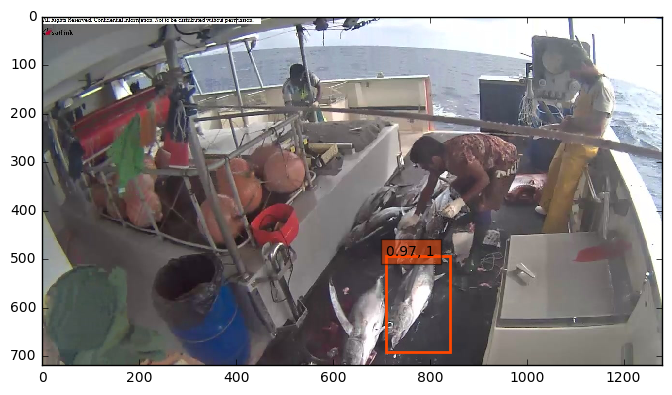

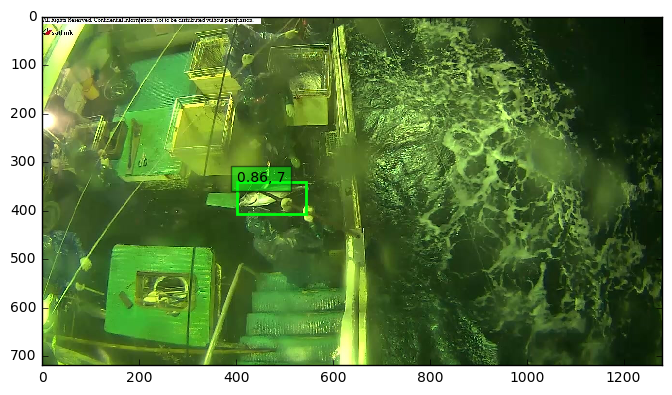

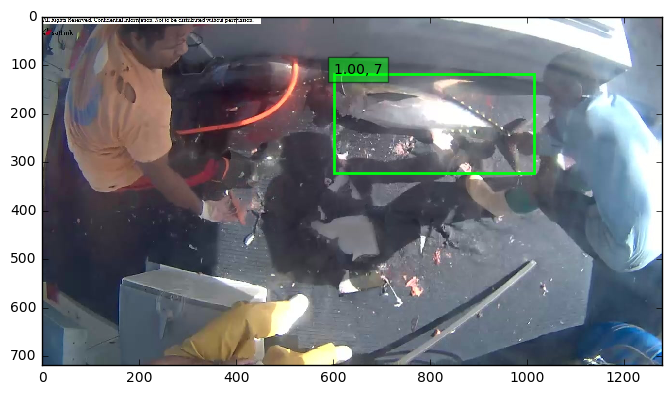

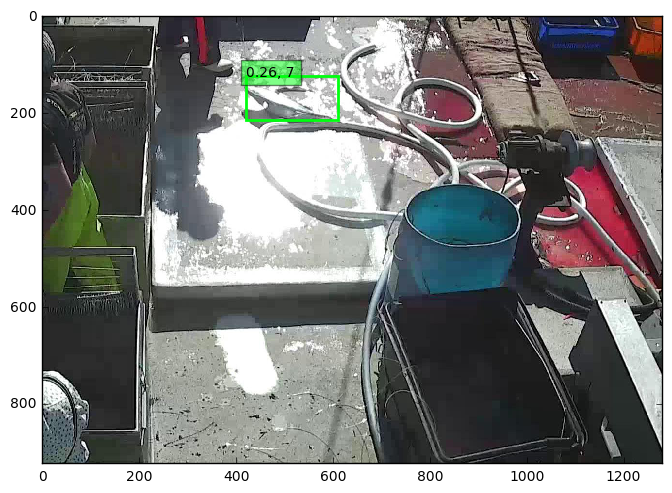

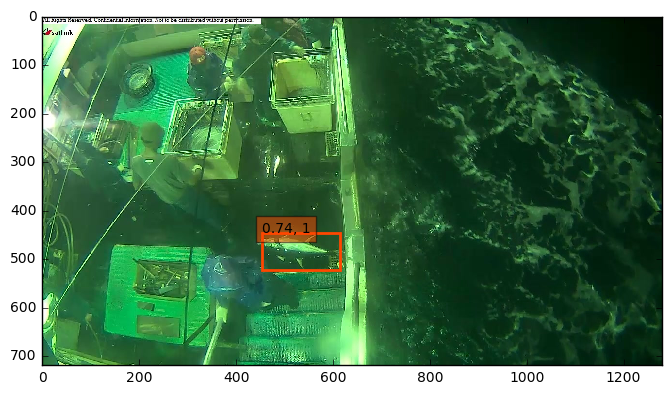

...

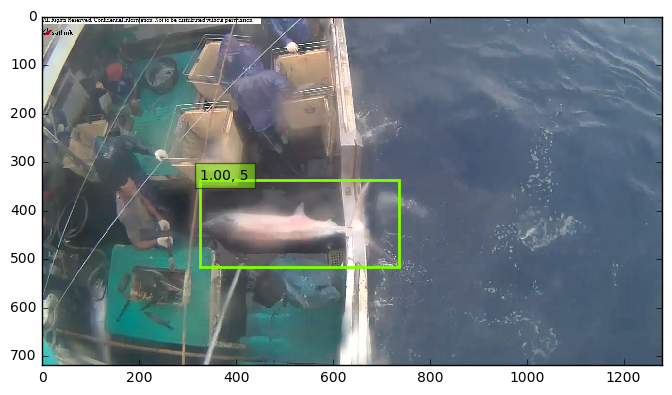

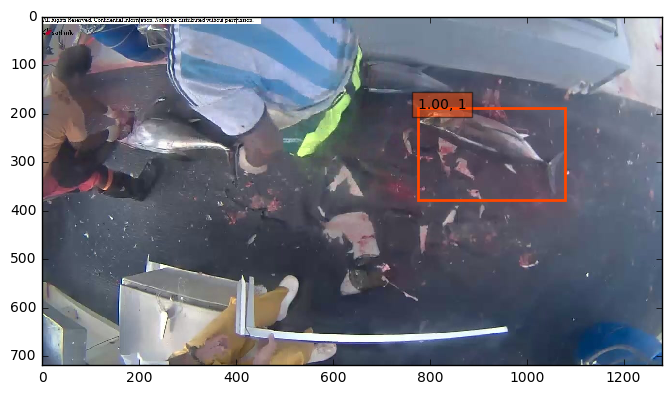

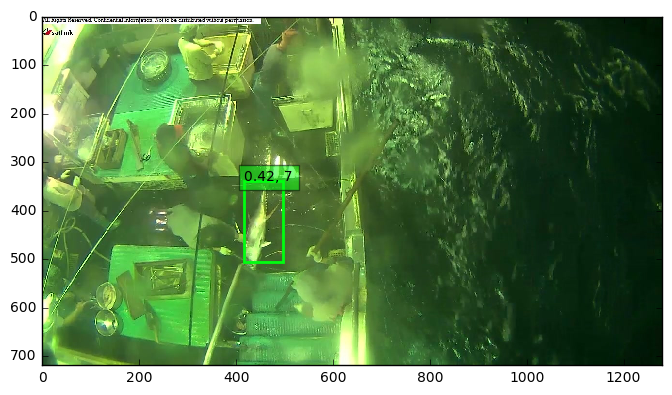

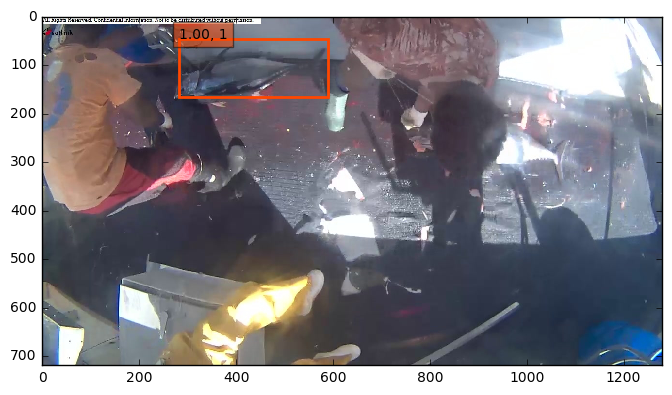

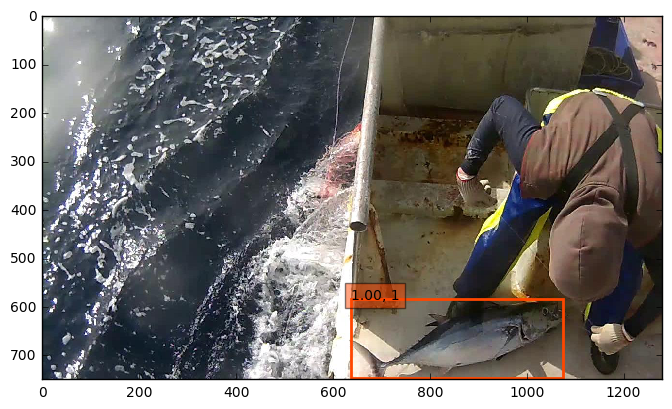

In [71]:
for i, img in enumerate(images):
    # Parse the outputs.
    det_label = results[i][:, 0]
    det_conf = results[i][:, 1]
    det_xmin = results[i][:, 2]
    det_ymin = results[i][:, 3]
    det_xmax = results[i][:, 4]
    det_ymax = results[i][:, 5]

    # Get detections with confidence higher than 0.6.
#     top_indices = [i for i, conf in enumerate(det_conf) if conf >= 0.6]
    top_indices = [np.argmax(det_conf)]

    top_conf = det_conf[top_indices]
    top_label_indices = det_label[top_indices].tolist()
    top_xmin = det_xmin[top_indices]
    top_ymin = det_ymin[top_indices]
    top_xmax = det_xmax[top_indices]
    top_ymax = det_ymax[top_indices]

    colors = plt.cm.hsv(np.linspace(0, 1, 21)).tolist()

    plt.imshow(img / 255.)
    currentAxis = plt.gca()

    for i in range(top_conf.shape[0]):
        xmin = int(round(top_xmin[i] * img.shape[1]))
        ymin = int(round(top_ymin[i] * img.shape[0]))
        xmax = int(round(top_xmax[i] * img.shape[1]))
        ymax = int(round(top_ymax[i] * img.shape[0]))
        score = top_conf[i]
        label = int(top_label_indices[i])
#         label_name = voc_classes[label - 1]
#         print label
#         print len(colors)
        display_txt = '{:0.2f}, {}'.format(score, label)
        coords = (xmin, ymin), xmax-xmin+1, ymax-ymin+1
        color = colors[label]
        currentAxis.add_patch(plt.Rectangle(*coords, fill=False, edgecolor=color, linewidth=2))
        currentAxis.text(xmin, ymin, display_txt, bbox={'facecolor':color, 'alpha':0.5})
    
    plt.show()